# **Fine-Grained Object Detection with YOLO11 Utilizing the Stanford Dogs Dataset**

In this notebook, the [YOLO11](https://docs.ultralytics.com/models/yolo11/) model from [Ultralytics](https://www.ultralytics.com/) is fine-tuned, which is the latest and most advanced deep learning model in the YOLO series for real-time object detection. The YOLO11 models are pretrained on the [COCO](https://docs.ultralytics.com/datasets/detect/coco/#coco-pretrained-models) dataset, which consists of 200,000 images and 80 object categories, providing a strong foundation for general object detection tasks. Fine-tuning is performed using the [Stanford Dogs dataset](http://vision.stanford.edu/aditya86/ImageNetDogs/). This dataset contains 20,580 RGB images of 120 dog breeds from around the world, with 12,000 images for training and 8,500 for validation. Each image may contain one or more instances (dogs) of the same breed. Stanford Dogs is commonly used for fine-grained image classification, which is a more challenging task than traditional image classification due to the presence of visually similar breeds that complicate the classification process.

In this notebook, however, the dataset is utilized for object detection, which is even more challenging than fine-grained image classification, as it requires detecting the bounding boxes for each instance. Therefore, it is essential to employ the best current models. In this case, the **YOLO11l** model, currently the second-best model from Ultralytics, will be fine-tuned, as will be demonstrated later.



## **Imports**

In [ ]:
# Installation of the Ultralytics library
!pip install ultralytics -q

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 882.7/882.7 kB 26.8 MB/s eta 0:00:00


In [ ]:
from ultralytics import YOLO
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import numpy as np
import pandas as pd
from PIL import Image
from google.colab import drive
from glob import glob
from sklearn.metrics import ConfusionMatrixDisplay
from IPython.display import clear_output, Video
import yaml
import os

# Necessary in Colab with Ultralytics to prevent path-related encoding errors
import locale
locale.getpreferredencoding = lambda: "UTF-8"

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [ ]:
# Mount Google Drive in Colab
drive.mount("/content/drive")

Mounted at /content/drive


## **Parameters**

In [ ]:
batch_size = 16
epochs = 50
patience = 5
zip_dataset = "/content/drive/MyDrive/Datasets/StanfordDogs.zip"
path_dataset = "/content/datasets/StanfordDogs"
path_save_results = "/content/drive/MyDrive/Ultralytics"

## **Preparing the Dataset for Training**

### **Load the Dataset**

The download, along with all the preprocessing and analysis of the Stanford Dogs dataset, has been completed in the following notebook: [Preprocessing_StanfordDogs](https://github.com/JersonGB22/ObjectDetection-TensorFlow-PyTorch/blob/main/Preprocessing/Preprocessing_StanfordDogs.ipynb). Therefore, in this case, it will only be necessary to unzip the zip file.

In [ ]:
!unzip -q $zip_dataset -d /content/datasets

### **Visualization Example**

Next, an example of the training dataset is manually plotted. With Ultralytics, data augmentation, training, and inference are very straightforward processes, so it won't even be necessary to plot the images with their respective bounding boxes, as will be demonstrated later.

In [ ]:
# Extract the class names from the YAML file
with open(os.path.join(path_dataset, "data.yaml"), "r") as archivo:
    class_names = yaml.safe_load(archivo)["names"]

print(class_names)

['affenpinscher', 'afghan hound', 'african hunting dog', 'airedale', 'american staffordshire terrier', 'appenzeller', 'australian terrier', 'basenji', 'basset', 'beagle', 'bedlington terrier', 'bernese mountain dog', 'black and tan coonhound', 'blenheim spaniel', 'bloodhound', 'bluetick', 'border collie', 'border terrier', 'borzoi', 'boston bull', 'bouvier des flandres', 'boxer', 'brabancon griffon', 'briard', 'brittany spaniel', 'bull mastiff', 'cairn', 'cardigan', 'chesapeake bay retriever', 'chihuahua', 'chow', 'clumber', 'cocker spaniel', 'collie', 'curly coated retriever', 'dandie dinmont', 'dhole', 'dingo', 'doberman', 'english foxhound', 'english setter', 'english springer', 'entlebucher', 'eskimo dog', 'flat coated retriever', 'french bulldog', 'german shepherd', 'german short haired pointer', 'giant schnauzer', 'golden retriever', 'gordon setter', 'great dane', 'great pyrenees', 'greater swiss mountain dog', 'groenendael', 'ibizan hound', 'irish setter', 'irish terrier', 'iris

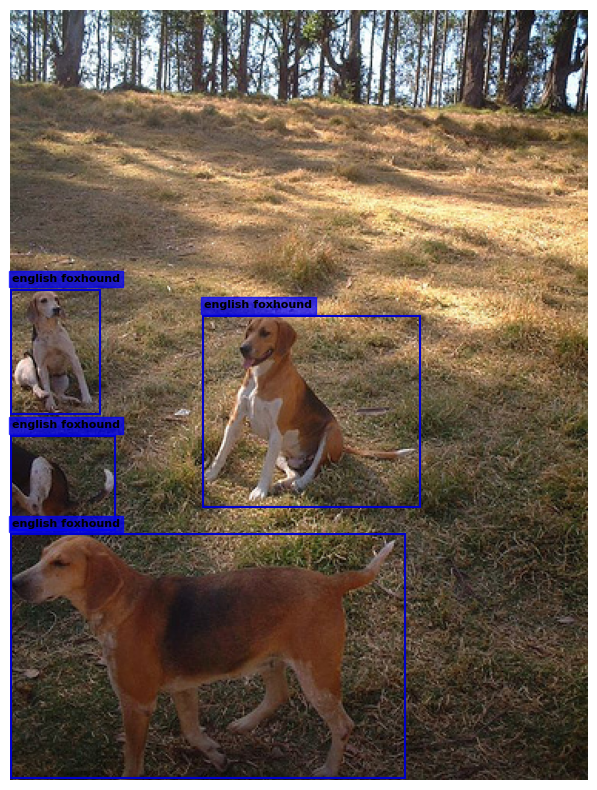

In [ ]:
fig, ax = plt.subplots(1, figsize=(12, 10))

image = Image.open("/content/datasets/StanfordDogs/train/images/n02089973_2791.jpg")
image = np.array(image)
shape = image.shape
ax.imshow(image)

annotation = np.loadtxt("/content/datasets/StanfordDogs/train/labels/n02089973_2791.txt")
annotation = annotation[None, :] if annotation.ndim == 1 else annotation
classes = annotation[:, 0]
boxes = annotation[:, 1:]

for i in range(len(boxes)):
  box = boxes[i]
  cls = classes[i].astype(np.int32)

  x_center, y_center, width, height = tuple(box)
  xmin = (x_center - width / 2) * shape[1]
  ymin = (y_center - height / 2) * shape[0]
  xmax = (x_center + width / 2) * shape[1]
  ymax = (y_center + height / 2) * shape[0]

  rect = patches.Rectangle((xmin, ymin), xmax-xmin, ymax-ymin, linewidth=1.5, edgecolor="mediumblue", facecolor="none")
  ax.add_patch(rect)

  ax.text(
      x=xmin+shape[1]*0.002, y=ymin-shape[0]*0.007, s=f"{class_names[cls]}",
      color="black", fontsize=8, fontweight="bold", ha="left", va="bottom",
      bbox={"boxstyle":"square", "facecolor": "blue", "edgecolor":"blue", "alpha":0.7}
  )

ax.axis("off");

## **Initializing and Training the Model**

The YOLO model downloaded from the Ultralytics GitHub is a **PyTorch** model, meaning it cannot currently be trained on Colab's TPU to accelerate the process. In this case, the specific version used is **YOLO11l**, which has over 25 million parameters. With Ultralytics, it is not necessary to specify the optimizer or the learning rate, as these are automatically selected based on the dataset size and the number of epochs. In this particular case, this setup is best suited for the Stanford Dogs dataset. Freezing the backbone layers, in this case, drastically worsens the model's precision, so it is not applied. Furthermore, due to the more challenging fine-grained classification, the weight of the classification loss is increased from 0.5 to 1.5 (``cls=1.5``) to achieve the best results.

Regarding data augmentation to make the model more robust and prevent overfitting, with Ultralytics, it is simply a matter of adjusting the values of each transformation since everything is implemented with the [Albumentations](https://albumentations.ai/) library.

During training, the YOLO model uses the following three losses:

- **box_loss**: This is the **Complete Intersection over Union (CIoU) Loss**. This loss function considers not only the overlap between the predicted and actual bounding boxes but also the distance between their centers and the aspect ratio. This makes it a more thorough metric for assessing box alignment. It surpasses the performance of IoU (Intersection over Union), GIoU (Generalized IoU), and DIoU (Distance IoU) losses.

- **cls_loss**: This is the **Binary Cross Entropy loss with logits** applied to the model's classifier.

- **dfl_loss**: This refers to the **Distribution Focal Loss (DFL)**, an enhanced variant of the focal loss aimed at giving greater emphasis to difficult-to-classify instances. It modifies the focal loss according to the class distribution, enhancing the model's sensitivity to minority classes and helping to address class imbalance.

Lastly, since the training time for YOLO models can be lengthy, Ultralytics provides options to resume training from where it left off. This is useful in case of interruptions or if the free GPU time of 3 hours and 40 minutes on Google Colab is exceeded. In this case, the total training takes approximately **9 hours**, configuring 50 epochs and a patience value of 5.

In [ ]:
## @title Choose Whether to Resume Training
pretrained = True # @param {type:"boolean"}

In [ ]:
name_project = os.path.join(path_save_results, "ObjectDetection_YOLO11l_StanfordDogs")

In [ ]:
if pretrained:
  model = YOLO(os.path.join(name_project, "weights/last.pt"))
else:
  model = YOLO("yolo11l.pt")

model.info()

YOLO11l summary: 631 layers, 25,403,000 parameters, 0 gradients, 87.8 GFLOPs


(631, 25403000, 0, 87.78552320000001)

In [ ]:
if pretrained:
  results = model.train(resume=True)

else:
  results = model.train(
      data=os.path.join(path_dataset, "data.yaml"),
      epochs=epochs,
      patience=patience,
      batch=batch_size,
      imgsz=640,
      cls=1.5,
      deterministic=True, #Allows for reproducibility of the training
      verbose=False,
      project=path_save_results,
      name=name_project,

  # Data Augmentation
      hsv_h=0.015, #Randomly adjusts the hue of the image within the range [1-0.015; 1+0.015]
      hsv_s=0.3, #Randomly adjusts the saturation of the image within the range [1-0.3; 1+0.3]
      hsv_v=0.4, #Randomly adjusts the brightness of the image within the range [1-0.4; 1+0.4]
      translate=0.1, #Randomly shifts the image horizontally and vertically by up to 10% of its original size
      scale=0.25, #Randomly scales the image size within the range of [100%-25%; 100%+25%]
      fliplr=0.5, #Horizontal flip of the image with a probability of 0.5
      mosaic=1.0, #Combines 4 images into one with a probability of 1
      close_mosaic=0, #Allows applying the mosaic in all epochs
      erasing=0.25 #Erase up to 25% of the image
  )

Ultralytics 8.3.10 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=/content/drive/MyDrive/Ultralytics/ObjectDetection_YOLO11l_StanfordDogs/weights/last.pt, data=/content/datasets/StanfordDogs/data.yaml, epochs=50, time=None, patience=5, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/drive/MyDrive/Ultralytics, name=ObjectDetection_YOLO11l_StanfordDogs, exist_ok=False, pretrained=True, optimizer=auto, verbose=False, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=0, resume=/content/drive/MyDrive/Ultralytics/ObjectDetection_YOLO11l_StanfordDogs/weights/last.pt, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffe

100%|██████████| 755k/755k [00:00<00:00, 93.7MB/s]


TensorBoard: Start with 'tensorboard --logdir /content/drive/MyDrive/Ultralytics/ObjectDetection_YOLO11l_StanfordDogs', view at http://localhost:6006/

                   from  n    params  module                                       arguments                     
  0                  -1  1      1856  ultralytics.nn.modules.conv.Conv             [3, 64, 3, 2]                 
  1                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  2                  -1  2    173824  ultralytics.nn.modules.block.C3k2            [128, 256, 2, True, 0.25]     
  3                  -1  1    590336  ultralytics.nn.modules.conv.Conv             [256, 256, 3, 2]              
  4                  -1  2    691712  ultralytics.nn.modules.block.C3k2            [256, 512, 2, True, 0.25]     
  5                  -1  1   2360320  ultralytics.nn.modules.conv.Conv             [512, 512, 3, 2]              
  6                  -1  2   2234368  ultralytics.

100%|██████████| 5.35M/5.35M [00:00<00:00, 315MB/s]


AMP: checks passed ✅


train: Scanning /content/datasets/StanfordDogs/train/labels... 12000 images, 0 backgrounds, 1 corrupt: 100%|██████████| 12000/12000 [00:06<00:00, 1802.07it/s]

train: WARNING ⚠️ /content/datasets/StanfordDogs/train/images/n02089973_1763.jpg: corrupt JPEG restored and saved
train: WARNING ⚠️ /content/datasets/StanfordDogs/train/images/n02106030_3948.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0278]


train: New cache created: /content/datasets/StanfordDogs/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


/usr/local/lib/python3.10/dist-packages/albumentations/__init__.py:13: UserWarning: A new version of Albumentations is available: 1.4.18 (you have 1.4.15). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()
val: Scanning /content/datasets/StanfordDogs/valid/labels... 8580 images, 0 backgrounds, 0 corrupt: 100%|██████████| 8580/8580 [00:08<00:00, 1029.30it/s]

val: WARNING ⚠️ /content/datasets/StanfordDogs/valid/images/n02089973_2054.jpg: corrupt JPEG restored and saved


val: New cache created: /content/datasets/StanfordDogs/valid/labels.cache
Plotting labels to /content/drive/MyDrive/Ultralytics/ObjectDetection_YOLO11l_StanfordDogs/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=8.1e-05, momentum=0.9) with parameter groups 167 weight(decay=0.0), 174 weight(decay=0.0005), 173 bias(decay=0.0)
Resuming training /content/drive/MyDrive/Ultralytics/ObjectDetection_YOLO11l_StanfordDogs/weights/last.pt from epoch 39 to 50 total epochs
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to /content/drive/MyDrive/Ultralytics/ObjectDetection_YOLO11l_StanfordDogs
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      11.4G     0.5036      2.072      1.105         50        640: 100%|██████████| 750/750 [09:28<00:00,  1.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 269/269 [02:11<00:00,  2.04it/s]


                   all       8580       9249      0.809      0.798      0.855      0.785

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      11.2G     0.5009      2.026      1.103         38        640: 100%|██████████| 750/750 [09:33<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 269/269 [02:09<00:00,  2.07it/s]


                   all       8580       9249      0.814      0.795      0.856      0.784

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      11.2G     0.4969      1.958        1.1         38        640: 100%|██████████| 750/750 [09:32<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 269/269 [02:10<00:00,  2.07it/s]


                   all       8580       9249      0.825      0.781      0.852      0.783

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      11.2G     0.4908      1.904      1.098         43        640: 100%|██████████| 750/750 [09:31<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 269/269 [02:10<00:00,  2.05it/s]


                   all       8580       9249      0.819      0.788      0.851      0.783

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      11.2G     0.4913      1.856      1.096         36        640: 100%|██████████| 750/750 [09:32<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 269/269 [02:09<00:00,  2.08it/s]


                   all       8580       9249      0.798      0.804      0.852      0.784

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      11.2G     0.4858      1.808      1.092         42        640: 100%|██████████| 750/750 [09:32<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 269/269 [02:10<00:00,  2.07it/s]


                   all       8580       9249      0.817      0.789      0.852      0.783
EarlyStopping: Training stopped early as no improvement observed in last 5 epochs. Best results observed at epoch 39, best model saved as best.pt.
To update EarlyStopping(patience=5) pass a new patience value, i.e. `patience=300` or use `patience=0` to disable EarlyStopping.

6 epochs completed in 1.181 hours.
Optimizer stripped from /content/drive/MyDrive/Ultralytics/ObjectDetection_YOLO11l_StanfordDogs/weights/last.pt, 51.4MB
Optimizer stripped from /content/drive/MyDrive/Ultralytics/ObjectDetection_YOLO11l_StanfordDogs/weights/best.pt, 51.4MB

Validating /content/drive/MyDrive/Ultralytics/ObjectDetection_YOLO11l_StanfordDogs/weights/best.pt...
Ultralytics 8.3.10 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLO11l summary (fused): 464 layers, 25,371,832 parameters, 0 gradients, 87.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 269/269 [02:06<00:00,  2.13it/s]


                   all       8580       9249      0.809      0.797      0.855      0.786
Speed: 0.2ms preprocess, 10.3ms inference, 0.0ms loss, 1.1ms postprocess per image
Results saved to /content/drive/MyDrive/Ultralytics/ObjectDetection_YOLO11l_StanfordDogs


## **Model Evaluation**

Upon completing the training, Ultralytics automatically evaluates the model's performance on the validation dataset, generating performance metrics and their corresponding graphs. Among the most important metrics are the following:

- **Precision (Box):** This metric measures the proportion of correct predictions among all predictions made by the model. It is calculated as the number of true positives (TP) divided by the sum of true positives and false positives (FP).

  - **True Positives (TP):** A true positive is considered when the predicted bounding box and the ground truth box have an Intersection over Union (IoU) of at least 0.5 and belong to the same class. This means the model has not only detected the presence of an object but has also accurately located its position and category.
  
  - **False Positives (FP):** A false positive occurs when the model predicts that an object is present (i.e., it generates a bounding box), but there is actually no corresponding object in the image, or the detected object does not match the real class.

  - **False Negatives (FN):** A false negative occurs when the model fails to detect an object that is present in the image. This means there is a real box, but the model does not generate any corresponding prediction for that object.

- **Recall (Box):** This metric measures the proportion of correctly detected objects among all objects that are actually present in the image. It is calculated as the number of true positives (TP) divided by the sum of true positives and false negatives (FN).

- **mAP50:** The mean Average Precision at an IoU threshold of 0.5, where Average Precision (AP) computes the area under the precision-recall curve. This metric provides an overview of the model's ability to accurately detect objects by averaging precision across different classes, with the IoU threshold fixed at 0.5. This is a standard metric used in the COCO dataset evaluation.

- **mAP50-95:** The mean Average Precision across multiple IoU thresholds ranging from 0.5 to 0.95, incremented by 0.05. This metric offers a more comprehensive assessment of the model's performance, considering varying levels of object localization precision. Similar to mAP50, this metric is also employed in COCO evaluations, allowing for a standardized comparison across different models.

All these metrics range from **0** to **1**. A value of **0** indicates poor performance (no correct predictions), while a value of **1** indicates perfect performance (all predictions are correct).

### **Loss and Metrics Graphs**

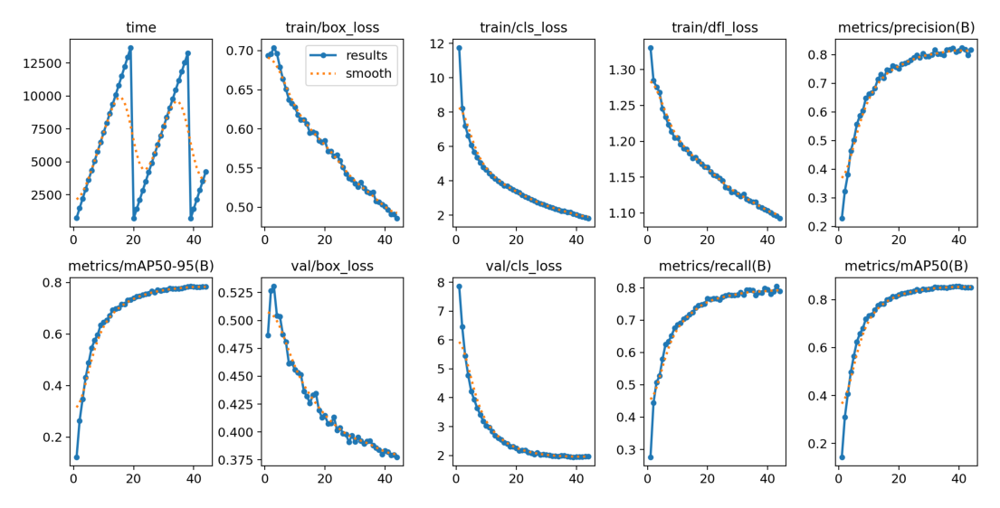

In [ ]:
plt.figure(figsize=(14, 8))

img = Image.open(os.path.join(name_project, "results.png"))
plt.imshow(img)
plt.axis("off");

It can be observed that the mAP50 and mAP50-95 metrics for the validation dataset converge, plateau, and no longer increase in the last epochs. Similarly, the accuracy of the training dataset oscillates around a fixed value during those epochs. This indicates that the model has reached its maximum and optimal performance at **39 epochs**, having successfully converged. This means that the patience value was effective in preventing overfitting and unnecessarily prolonging the model's training. Training for more epochs would not yield any improvement, suggesting that the best optimizers and learning rate have been chosen, allowing the model to reach its full potential in fewer than 50 epochs.

### **Detailed Evaluation of the Validation Dataset**

Although the model automatically generates validation metrics and graphs upon completing the training, this evaluation can also be performed using ``model.eval()``. By adding the argument ``verbose=True``, more detailed metrics for each class will be printed to the screen.

In [ ]:
path_eval = os.path.join(name_project, "yolo11l_eval")

In [ ]:
results = model.val(
    data=os.path.join(path_dataset, "data.yaml"),
    name=path_eval,
    verbose=True
)

Ultralytics 8.3.10 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLO11l summary (fused): 464 layers, 25,371,832 parameters, 0 gradients, 87.1 GFLOPs


val: Scanning /content/datasets/StanfordDogs/valid/labels.cache... 8580 images, 0 backgrounds, 0 corrupt: 100%|██████████| 8580/8580 [00:00<?, ?it/s]

val: WARNING ⚠️ /content/datasets/StanfordDogs/valid/images/n02089973_2054.jpg: corrupt JPEG restored and saved



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 537/537 [04:04<00:00,  2.20it/s]


                   all       8580       9249      0.809      0.797      0.855      0.785
         affenpinscher         50         51      0.886      0.843      0.934      0.823
          afghan hound        139        160      0.974       0.94      0.987      0.933
   african hunting dog         69         88      0.962      0.852      0.955      0.828
              airedale        102        104      0.891      0.904      0.946      0.911
american staffordshire terrier         64         68      0.623      0.618       0.64       0.58
           appenzeller         51         54      0.491      0.759      0.749      0.686
    australian terrier         96        101      0.792      0.789      0.843      0.775
               basenji        109        117      0.908      0.841      0.924      0.856
                basset         75         78      0.882      0.859      0.905      0.833
                beagle         95        101      0.801      0.758      0.843      0.745
    bedlingto

Due to the large number of classes, it is preferable to visualize the evaluation results in a pandas DataFrame that includes the most relevant metrics for each class.

In [ ]:
class_names = list(results.names.values())
metrics = np.array([results.class_result(i) for i in range(len(class_names))])

df = pd.DataFrame({
    "Class": class_names,
    "Precision": metrics[:, 0],
    "Recall": metrics[:, 1],
    "mAP50": metrics[:, 2],
    "mAP50-95": metrics[:, 3]
})

df = df.sort_values(by="mAP50-95", ascending=False)
df

,Class,Precision,Recall,mAP50,mAP50-95
1,afghan hound,0.974096,0.940106,0.986537,0.933097
10,bedlington terrier,0.950269,0.896552,0.964216,0.928869
11,bernese mountain dog,0.935068,0.936642,0.966368,0.917432
69,leonberg,0.944613,0.884333,0.969032,0.914593
92,saint bernard,0.953540,0.972973,0.983794,0.913541
...,...,...,...,...,...
4,american staffordshire terrier,0.622864,0.617647,0.639683,0.580449
110,toy poodle,0.540975,0.611111,0.613571,0.577772
119,yorkshire terrier,0.552167,0.701891,0.625461,0.547556
76,miniature poodle,0.376731,0.438596,0.397649,0.346694


In [ ]:
df[df.mAP50 < 0.5]

,Class,Precision,Recall,mAP50,mAP50-95
76,miniature poodle,0.376731,0.438596,0.397649,0.346694
43,eskimo dog,0.282770,0.500000,0.340052,0.313387


In [ ]:
mask = df[df.mAP50 < 0.75]
print(mask.shape)
mask

(18, 5)


,Class,Precision,Recall,mAP50,mAP50-95
5,appenzeller,0.491389,0.759259,0.748832,0.686349
37,dingo,0.776826,0.703125,0.724444,0.681811
63,kelpie,0.688159,0.684211,0.701691,0.680681
89,redbone,0.633207,0.666667,0.736884,0.671595
113,walker hound,0.598516,0.690224,0.726747,0.667799
106,standard schnauzer,0.692453,0.703611,0.725600,0.654603
33,collie,0.529774,0.716667,0.733960,0.642060
90,rhodesian ridgeback,0.744907,0.657076,0.743129,0.633289
16,border collie,0.618421,0.740741,0.695325,0.620880
70,lhasa,0.531073,0.707849,0.657642,0.618169


In [ ]:
mask = df[df.mAP50 >= 0.9]
print(mask.shape)
mask

(54, 5)


,Class,Precision,Recall,mAP50,mAP50-95
1,afghan hound,0.974096,0.940106,0.986537,0.933097
10,bedlington terrier,0.950269,0.896552,0.964216,0.928869
11,bernese mountain dog,0.935068,0.936642,0.966368,0.917432
69,leonberg,0.944613,0.884333,0.969032,0.914593
92,saint bernard,0.953540,0.972973,0.983794,0.913541
83,otterhound,0.828890,0.907407,0.952474,0.913381
80,norwegian elkhound,0.945188,0.862230,0.961247,0.912407
95,schipperke,0.962626,0.888230,0.964365,0.911497
3,airedale,0.890654,0.903846,0.945921,0.911100
30,chow,0.906677,0.948980,0.970262,0.907057


The model has achieved a **mAP50** of **0.855** and a **mAP50-95** of **0.785** on the validation dataset, indicating very strong performance, especially considering that Fine-Grained Object Detection is a highly challenging task. Additionally, it is observed that precision is slightly higher than recall on the validation dataset, suggesting that the model tends to produce few false positives and detects instances in the images in a balanced manner. It is also noted that only two classes, ``miniature poodle`` and ``eskimo dog``, have a mAP50 below 0.5. This is due to the fact that these dog breeds are very similar to other breeds within the 120 classes, making them particularly difficult to detect accurately. Only 18 classes have a mAP50 below 0.75, while nearly 50% of the classes have a mAP50 of 0.9 or higher. These results reinforce the robustness of the model in this task.

### **Confusion Matrix**

The calculation of the confusion matrix in object detection is more complex than in image classification, as it considers not only the confidence score but also the overlap area of each prediction. Additionally, it includes a class called ``background`` that does not belong to any of the dataset classes. The confusion matrix provides a detailed analysis of the results, showing counts of true positives, false positives, and false negatives for each class, from which the precision and recall of the model in the validation set are derived.

In this case, due to the large number of classes, Ultralytics generates an empty confusion matrix, making it necessary to plot it manually. Additionally, displaying it directly as an image makes visualization difficult, so it is saved in SVG format and uploaded to my GitHub. The confusion matrix can be viewed at the following [link](https://raw.githubusercontent.com/JersonGB22/ObjectDetection-TensorFlow-PyTorch/main/images_videos/images_models/ConfusionMatrix_ObjectDetection_YOLO11l_StanfordDogs.svg).

In [ ]:
cm = results.confusion_matrix.matrix.astype(np.int32)
cmd = ConfusionMatrixDisplay(cm, display_labels=class_names+["background"])
fig, ax = plt.subplots(figsize=(35, 35))
cmd.plot(ax=ax, colorbar=False, cmap="coolwarm_r", xticks_rotation="vertical")

for text in ax.texts:
  text.set_fontsize(8)

ax.tick_params(axis="x", labelsize=8)
ax.tick_params(axis="y", labelsize=8)
plt.tight_layout()
fig.savefig("ConfusionMatrix_ObjectDetection_YOLO11l_StanfordDogs.svg", format="svg")
plt.close()

## **Inference with the Trained Model**

Inference with a fine-tuned Ultralytics YOLO model is straightforward, as it accepts a wide range of image and video formats for predictions. Additionally, the results are presented graphically and can be obtained in real time. All accepted formats are detailed in the official [Ultralytics documentation](https://docs.ultralytics.com/modes/predict/#inference-sources).

In [ ]:
# Load the trained model
model = YOLO(os.path.join(name_project, "weights/best.pt"))

### **Validation Dataset**

In [ ]:
# Extract all the paths of the validation images
images_val = glob(os.path.join(path_dataset, "valid/images/*jpg"))

In [ ]:
# Function for image inference
def object_detection(images, n_rows=2, n_cols=2, save=False, path_save=""):
  images = np.array(images)
  indices = np.arange(len(images))
  np.random.shuffle(indices)
  n_samples = int(n_rows * n_cols)

  results = model.predict(
      source=images[indices[:n_samples]].tolist(),
      imgsz=640,
      save=False,
      verbose=False
  )

  fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols*5, n_rows*5))
  axes = axes.flatten() if n_samples > 1 else [axes]

  for i, result in enumerate(results):
    result = result.plot()
    result = result[..., ::-1] #Convert the image to RGB format
    axes[i].imshow(result)
    axes[i].axis("off")

  plt.tight_layout()
  # Save images
  if save:
    plt.savefig(path_save)

  plt.show()

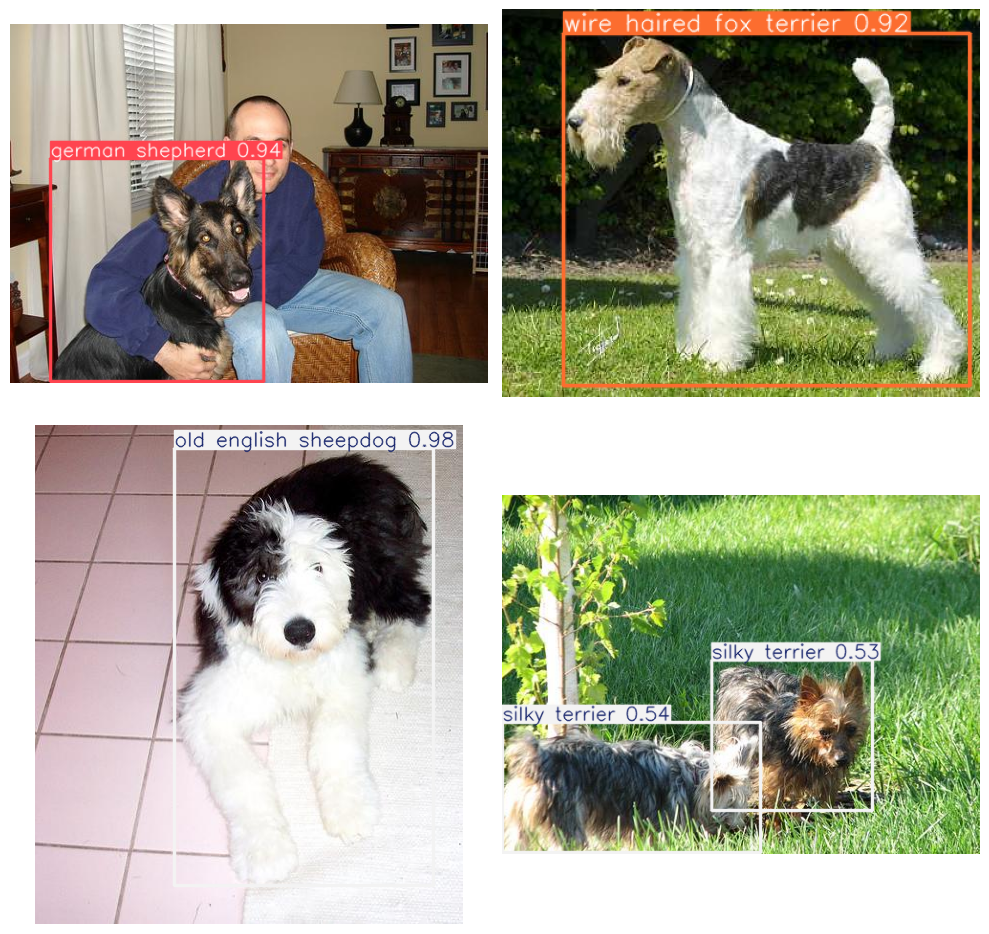

In [ ]:
object_detection(images_val)

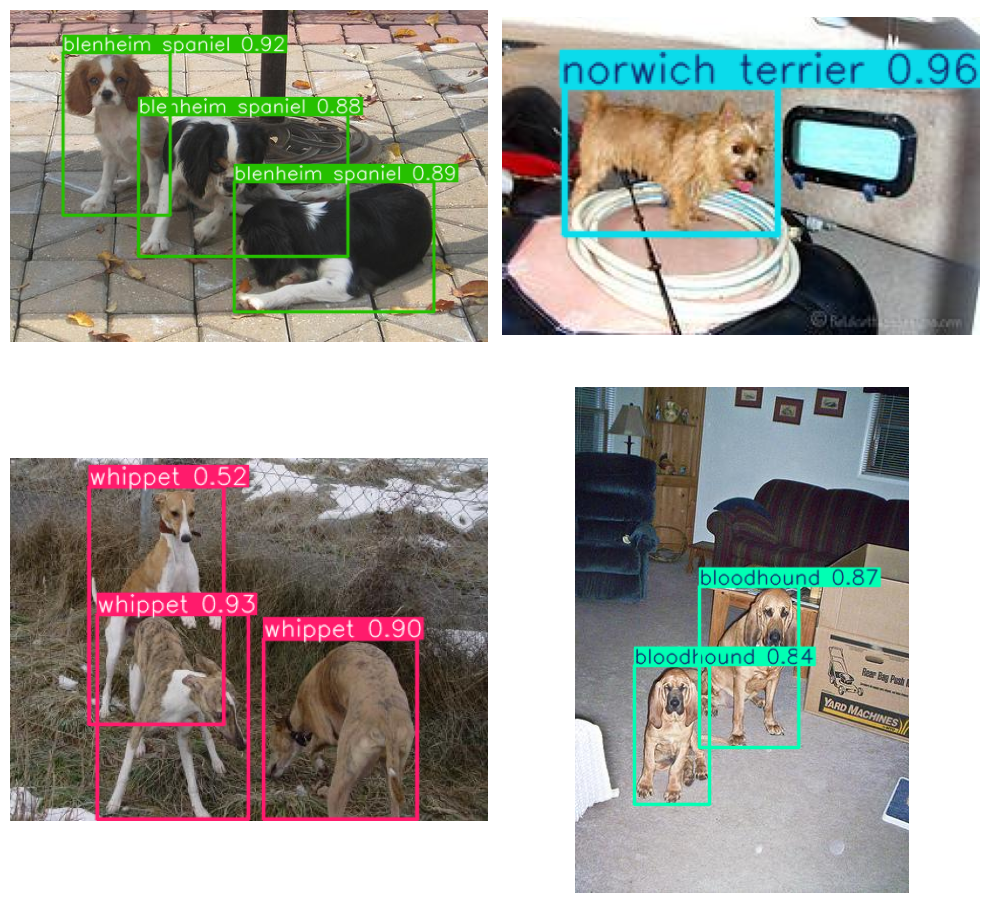

In [ ]:
object_detection(images_val)

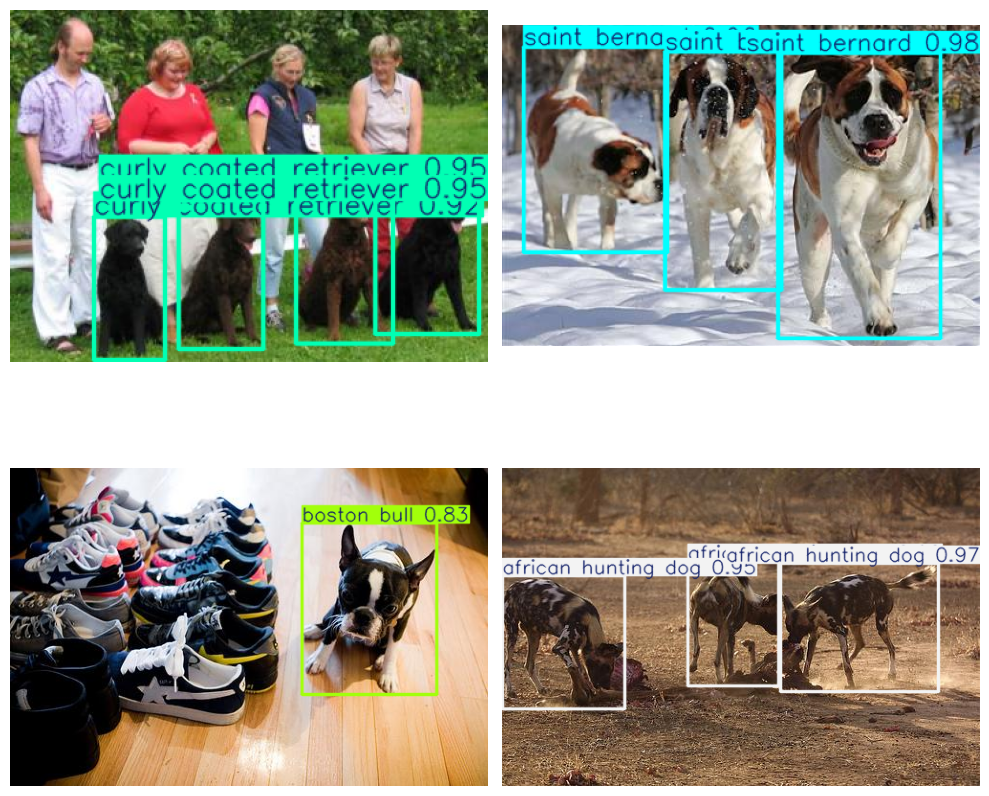

In [ ]:
object_detection(images_val)

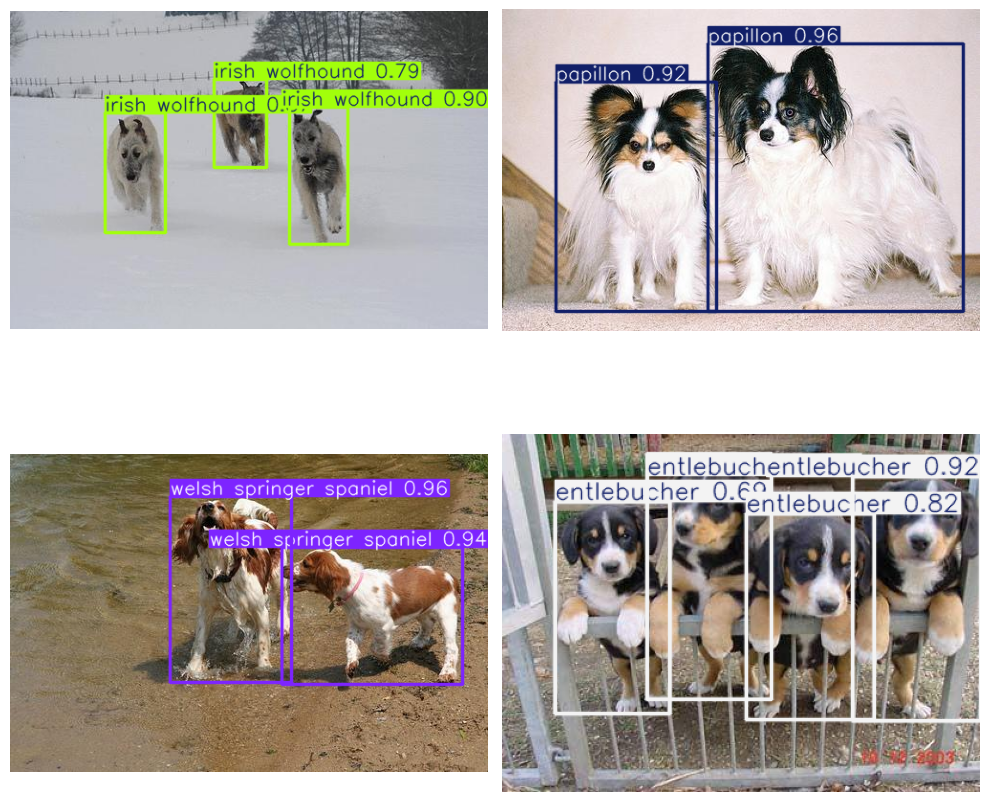

In [ ]:
object_detection(images_val)

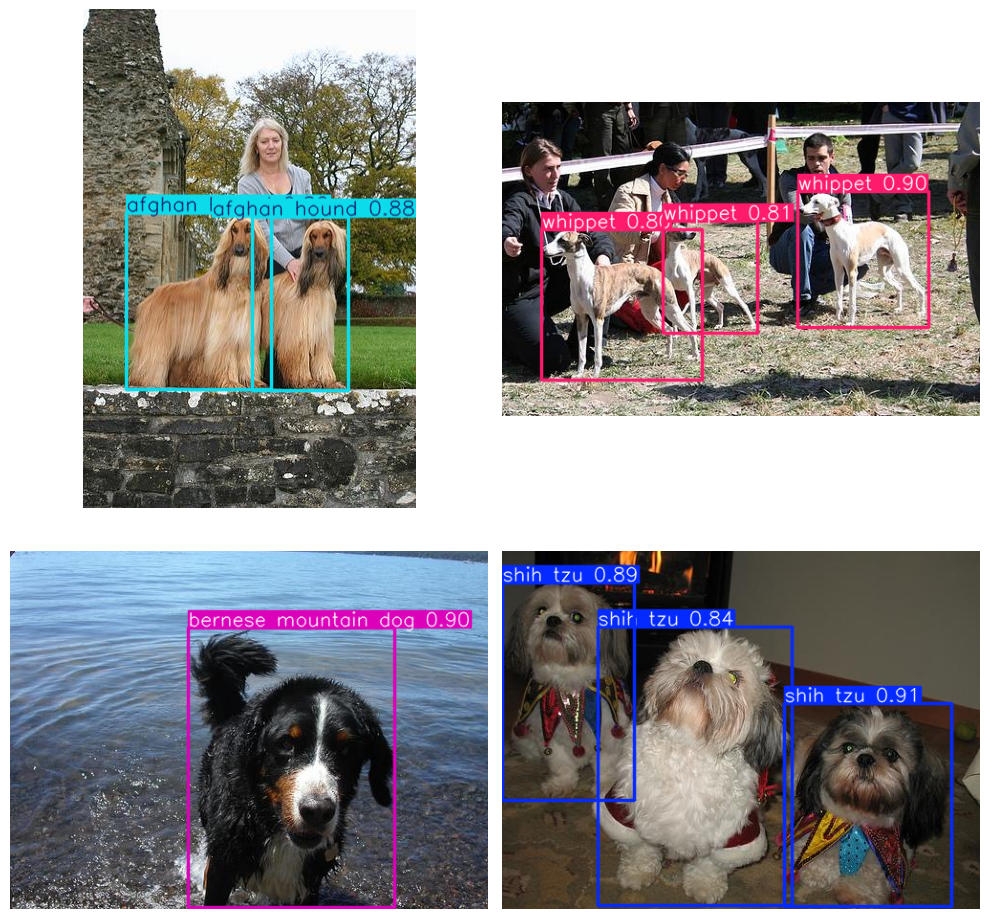

In [ ]:
object_detection(images_val)

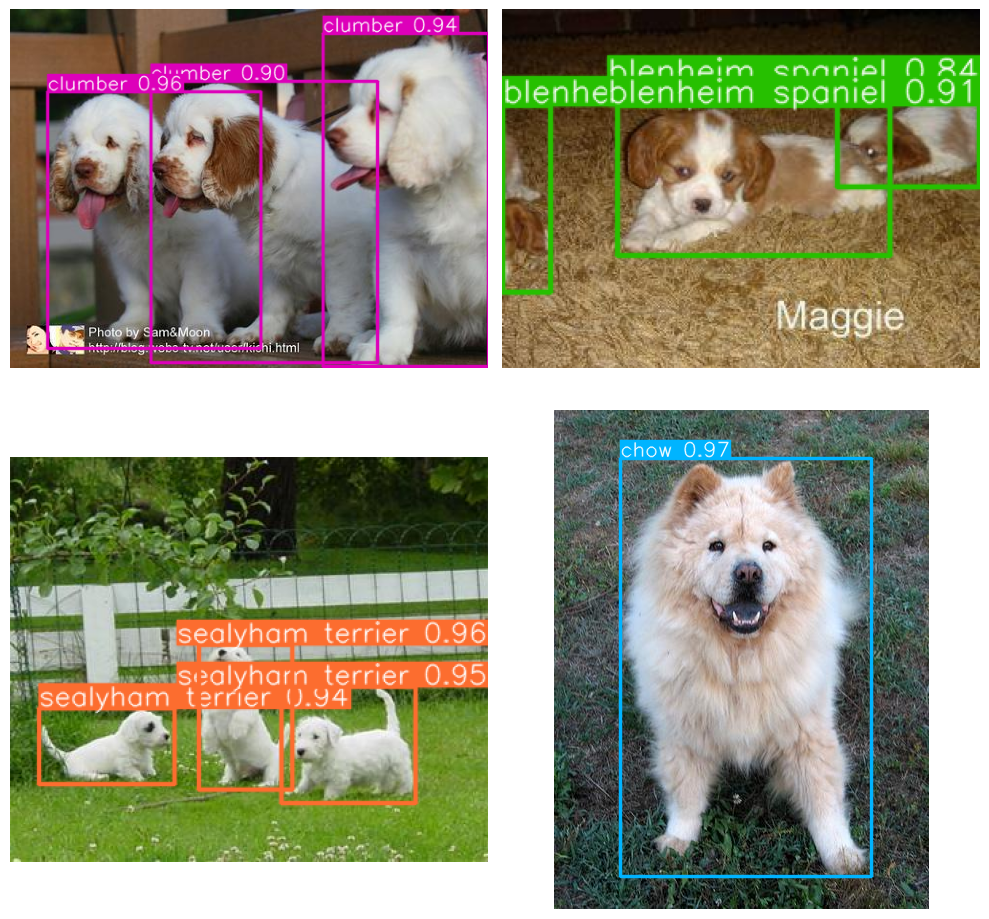

In [ ]:
object_detection(images_val)

### **Internet Images**

In [ ]:
url_images = [
    "https://i.ytimg.com/vi/OEmhJZMgj-4/hqdefault.jpg",
    "https://inaturalist-open-data.s3.amazonaws.com/photos/141127970/large.jpg",
    "https://www.dailypaws.com/thmb/q7354bW0neSdxFyp5lCPOzHV-9Q=/1500x0/filters:no_upscale():max_bytes(150000):strip_icc()/GettyImages-149263572-3eaf6cb6c08c4111833971ca5430bfc8.jpg",
    "https://www.irishsetterhealth.info/wp-content/uploads/2022/01/About_Irish_Setters.png",

    "https://i.pinimg.com/originals/5d/14/29/5d142906632767718bb8f2bc4d90f99e.jpg",
    "https://t3.ftcdn.net/jpg/09/89/33/22/360_F_989332265_9YuR22x1NSjPtedy0E8i8tZda4zqg9K9.jpg",
    "https://cdn.shopify.com/s/files/1/0758/9209/7323/files/amy-photo291-scaled-e1666743688732-640x574.jpg",
    "https://www.purina.co.uk/sites/default/files/styles/square_medium_440x440/public/2022-07/Poodle%20%28Standard%291.jpg?h=dfc28711&itok=EmD20zN0",

    "https://previews.123rf.com/images/travelarium/travelarium1811/travelarium181100521/111363108-dog-sledding-siberian-husky-sled-dog-team-in-harness-husky-dogs-has-a-black-and-white-coat-color.jpg",
    "https://wildearth.com/cdn/shop/articles/are-rottweilers-good-with-kids.jpg?v=1709589053",
    "https://img1.wsimg.com/isteam/ip/414fcd97-cd79-4b81-9ec9-047d5c214649/Portoer%20on%20Bridge.jpg/:/cr=t:0%25,l:0%25,w:100%25,h:100%25",
    "https://i.pinimg.com/736x/09/d0/cd/09d0cd0497e62342bc24d35d4c84b994.jpg",

    "https://www.ardeaprints.com/p/172/dog-affenpinscher-1313349.jpg.webp",
    "https://post.bark.co/wp-content/uploads/2019/09/brittany-spaniel-good-with-other-dogs.jpg",
    "https://www.kimballstock.com/pix/ani/p/04/dog-02-je0068-01p.jpg",
    "https://plus.unsplash.com/premium_photo-1717857017551-e58d39a3beec?fm=jpg&q=60&w=3000&ixlib=rb-4.0.3&ixid=M3wxMjA3fDB8MHxzZWFyY2h8NXx8cG9tZXJhbmlhbnxlbnwwfHwwfHx8MA%3D%3D"
]

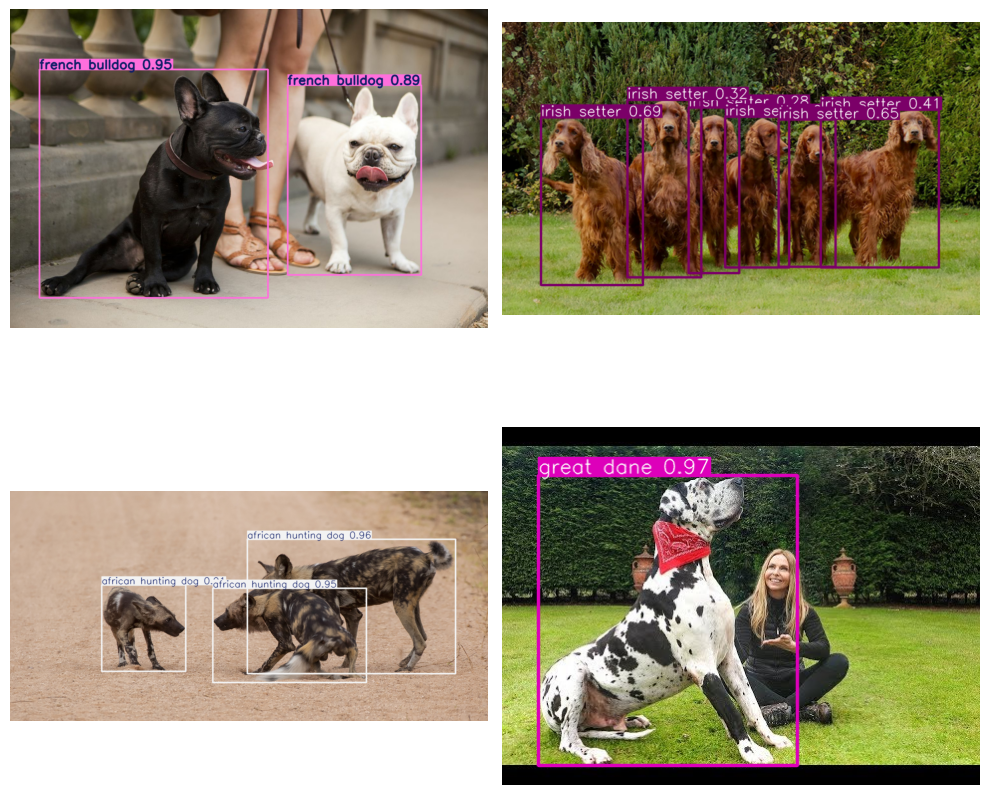

In [ ]:
object_detection(url_images[:4], save=True, path_save="ObjectDetection_YOLO11l_StanfordDogs_1.png")

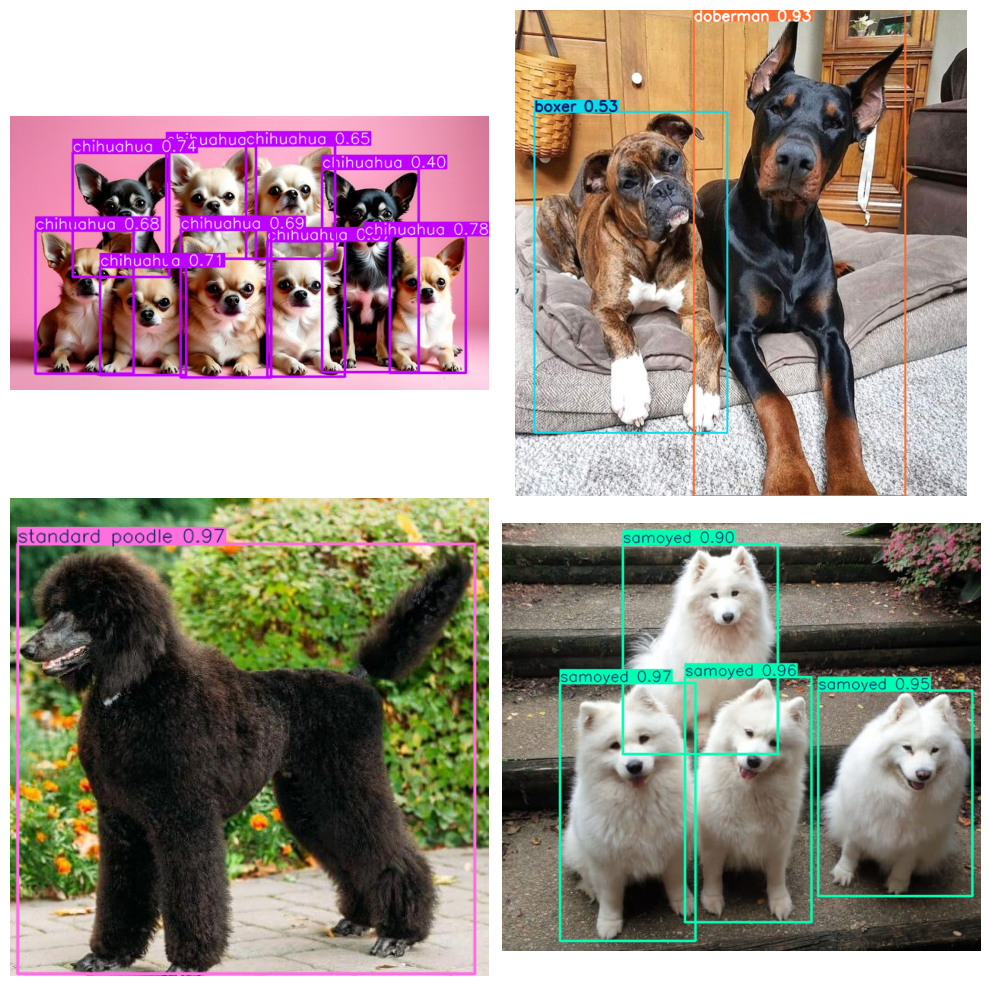

In [ ]:
object_detection(url_images[4:8], save=True, path_save="ObjectDetection_YOLO11l_StanfordDogs_2.png")

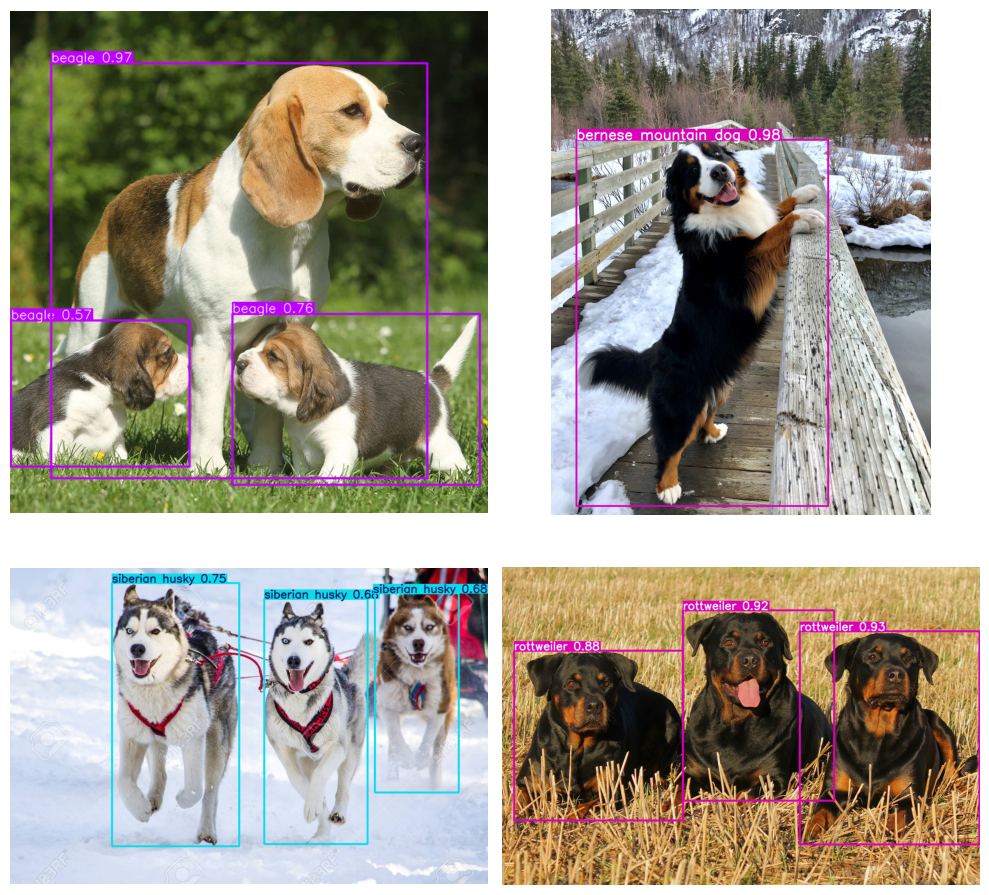

In [ ]:
object_detection(url_images[8:12], save=True, path_save="ObjectDetection_YOLO11l_StanfordDogs_3.png")

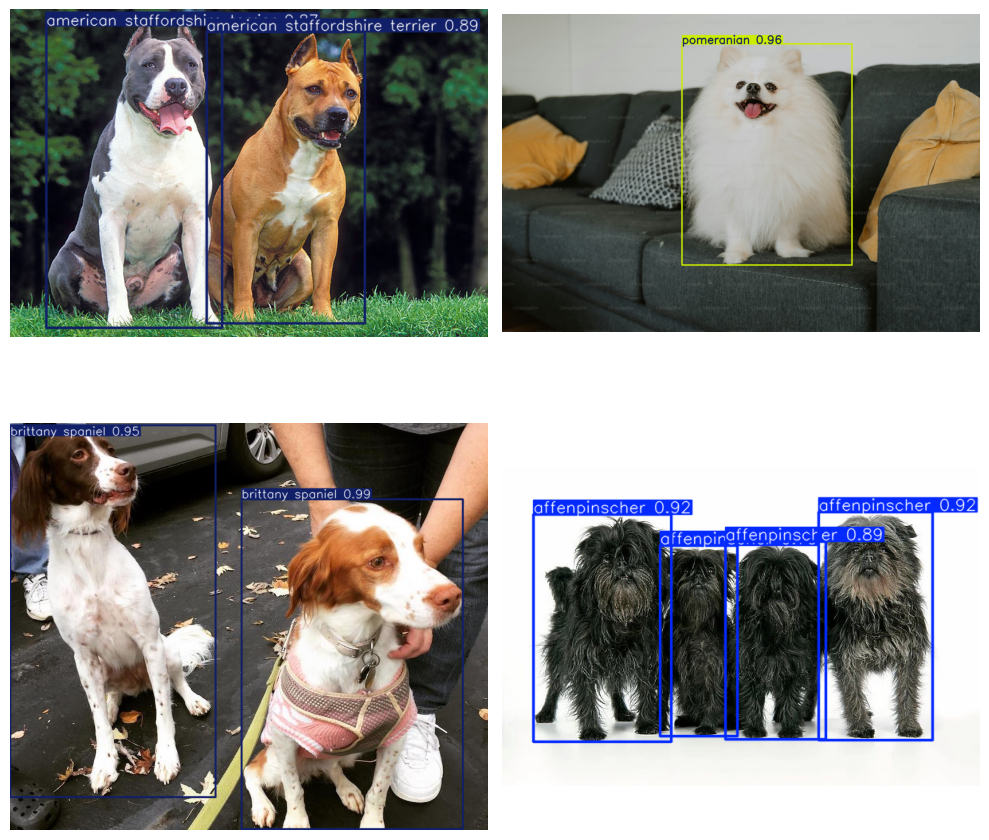

In [ ]:
object_detection(url_images[12:])

### **Video Inference**

The video is from the social media platform TikTok, so its format is not directly compatible with the formats supported by Ultralytics. Therefore, it is downloaded manually from the following [link](https://www.tiktok.com/@thedobieteam/video/6879856060102888706).

In [ ]:
url_video = "/content/drive/MyDrive/Videos/dobermans.mp4"
path_video = "ObjectDetection_YOLO11l_StanfordDogs.mp4"

In [ ]:
results = model.predict(
    source=url_video,
    stream=True,
    stream_buffer=True,
    vid_stride=1,
    save=True,
    save_frames=False,
    verbose=False
)

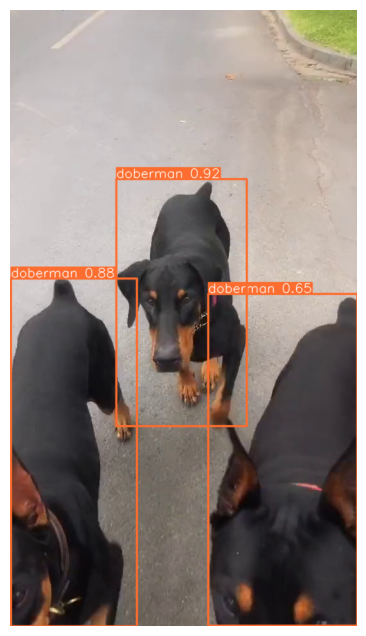

Results saved to runs/detect/predict


In [ ]:
for result in results:
  plt.figure(figsize=(10, 8))
  result = result.plot()
  result = result[..., ::-1]

  clear_output(wait=True)
  plt.imshow(result)
  plt.axis("off")
  plt.show()

In [ ]:
# Convert the video from AVI to MP4
!ffmpeg -i /content/runs/detect/predict/dobermans.avi $path_video -loglevel quiet -y

In [ ]:
Video(path_video, embed=True, width=600, height=400)

## **Conclusion**

The **YOLO11l** model fine-tuned on the Stanford Dogs dataset achieved a **mAP50** of **0.855** and a **mAP50-95** of **0.785** on the validation dataset. These results indicate that the model performs very well, despite the fact that fine-grained object detection is quite challenging. Additionally, this demonstrates that the best training hyperparameters and data augmentation techniques were chosen to achieve these results in this notebook. Better results could be obtained by expanding the training dataset with many more images and instances per image, as well as using Ultralytics' most advanced model, the **YOLO11x**. However, this would require significant manual effort in image collection and better computing resources than the free Colab GPU to speed up the training time. Nevertheless, based on the metric results and the inferences on images and videos, the fine-tuned model is already excellent for this task.

